In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import cv2
import numpy as np
import os

def load_bmp_images(directory):
  """
  Carga imágenes BMP desde un directorio.

  Args:
    directory: Ruta al directorio que contiene las imágenes BMP.

  Returns:
    Una lista de imágenes cargadas como arrays NumPy.
  """
  images = []
  for filename in os.listdir(directory):
    if filename.endswith(".bmp"):
      img_path = os.path.join(directory, filename)
      img = cv2.imread(img_path)
      if img is not None:
        images.append(img)
  return images


image_directory = "/content/drive/MyDrive/images bmp"
images = load_bmp_images(image_directory)

if len(images) > 0:
  print(f"Se cargaron {len(images)} imágenes BMP.")
else:
  print("No se encontraron imágenes BMP en el directorio especificado.")

Se cargaron 15 imágenes BMP.


#FILTROS

##FILTROS PARA PROCESAMIENTO DE LAS IMAGENES

###Transformacion FFT

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def procesar_imagen_fft(image_path, radio=100):
    """
    Procesa una imagen mediante la FFT, aplicando un filtro de paso bajo y mostrando los resultados.

    Parámetros:
        image_path (str): Ruta de la imagen a procesar.
        radio (int): Radio del filtro de paso bajo. El valor predeterminado es 100.

    Retorna:
        filtered_image (np.ndarray): Imagen filtrada.
    """
    # Cargar la imagen desde la ruta proporcionada
    img = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Separar los canales de color (R, G, B)
    r_channel, g_channel, b_channel = cv2.split(image_rgb)

    # Aplicar la FFT a cada canal de color y desplazar el cero al centro del espectro
    r_fft = np.fft.fftshift(np.fft.fft2(r_channel))
    g_fft = np.fft.fftshift(np.fft.fft2(g_channel))
    b_fft = np.fft.fftshift(np.fft.fft2(b_channel))

    # Calcular el espectro de magnitud (logaritmo para mejorar la visualización)
    r_magnitude = np.log(np.abs(r_fft) + 2)
    g_magnitude = np.log(np.abs(g_fft) + 2)
    b_magnitude = np.log(np.abs(b_fft) + 2)

    # Crear una máscara de filtro de paso bajo para eliminar el ruido de alta frecuencia
    rows, cols = r_channel.shape
    crow, ccol = rows // 2, cols // 2

    # Crear una máscara circular de paso bajo
    mask = np.zeros((rows, cols), np.uint8)
    cv2.circle(mask, (ccol, crow), radio, 1, thickness=-1)

    # Aplicar la máscara al espectro de cada canal
    r_fft_filtered = r_fft * mask
    g_fft_filtered = g_fft * mask
    b_fft_filtered = b_fft * mask

    # Calcular la FFT inversa para obtener la imagen filtrada
    r_ifft = np.fft.ifft2(np.fft.ifftshift(r_fft_filtered)).real
    g_ifft = np.fft.ifft2(np.fft.ifftshift(g_fft_filtered)).real
    b_ifft = np.fft.ifft2(np.fft.ifftshift(b_fft_filtered)).real

    # Normalizar los canales filtrados para visualización
    r_ifft_normalized = cv2.normalize(r_ifft, None, 0, 255, cv2.NORM_MINMAX)
    g_ifft_normalized = cv2.normalize(g_ifft, None, 0, 255, cv2.NORM_MINMAX)
    b_ifft_normalized = cv2.normalize(b_ifft, None, 0, 255, cv2.NORM_MINMAX)

    # Recombinar los canales filtrados para obtener la imagen mejorada
    image_filtered = cv2.merge([r_ifft_normalized, g_ifft_normalized, b_ifft_normalized]).astype(np.uint8)

    # Mostrar solo los espectros de magnitud, la imagen original y la imagen filtrada
    fig, axs = plt.subplots(1, 5, figsize=(20, 6))

    # Espectro de magnitud de cada canal
    axs[0].imshow(r_magnitude, cmap='gray')
    axs[0].set_title('Espectro - Canal R')
    axs[0].axis('off')

    axs[1].imshow(g_magnitude, cmap='gray')
    axs[1].set_title('Espectro - Canal G')
    axs[1].axis('off')

    axs[2].imshow(b_magnitude, cmap='gray')
    axs[2].set_title('Espectro - Canal B')
    axs[2].axis('off')

    # Imagen original
    axs[3].imshow(image_rgb)
    axs[3].set_title('Imagen Original')
    axs[3].axis('off')

    # Imagen filtrada
    axs[4].imshow(image_filtered)
    axs[4].set_title('Imagen Filtrada')
    axs[4].axis('off')

    plt.tight_layout()
    plt.show()

    # Retornar la imagen filtrada
    return image_filtered

###MODELO DE COLOR HSI

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2

def enhance_image_hsi(image_bgr):
    """
    Mejora la imagen utilizando el modelo de color HSI (Hue, Saturation, Intensity).
    Aumenta la saturación para hacer los colores más vivos y ajusta la intensidad
    para mejorar el brillo de la imagen. La imagen resultante se muestra en formato BGR.

    Parameters:
    - image_bgr: Imagen original en formato BGR (de OpenCV).

    Muestra las imágenes resultantes en un gráfico: la imagen original en BGR, la imagen
    en HSI (convertida a RGB para visualización), y la imagen mejorada con ajustes en saturación e intensidad.
    """
    # Convertir la imagen de BGR a RGB para trabajar con el modelo HSI
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    # Convertir la imagen de RGB a HSI usando la función personalizada
    img_hsi = rgb_to_hsi(image_rgb)

    # Separar los canales H (Hue), S (Saturation) e I (Intensity)
    h, s, i = img_hsi[:, :, 0], img_hsi[:, :, 1], img_hsi[:, :, 2]

    # Aumentar la saturación (hacer los colores más vivos) en un 30%
    s = s * 1.3  # Aumentar la saturación
    s = np.clip(s, 0, 1)  # Asegurarse de que la saturación no se pase de 1

    # Aumentar la intensidad (brillo) en un 20%
    i = i * 1.2  # Aumentar la intensidad
    i = np.clip(i, 0, 1)  # Asegurarse de que la intensidad no se pase de 1

    # Recomponer la imagen HSI con los nuevos valores de S y I
    enhanced_hsi = np.stack((h, s, i), axis=-1)

    # Convertir la imagen mejorada de HSI a RGB usando la función personalizada
    enhanced_image_rgb = hsi_to_rgb(enhanced_hsi)

    # Convertir la imagen mejorada a escala de 0-255 y tipo uint8
    enhanced_image_rgb = (enhanced_image_rgb * 255).astype(np.uint8)

    # Convertir la imagen mejorada de RGB a BGR para mostrarla en OpenCV
    enhanced_image_bgr = cv2.cvtColor(enhanced_image_rgb, cv2.COLOR_RGB2BGR)

    # Crear un plot con las imágenes
    plt.figure(figsize=(20, 5))

    # Imagen original en BGR (convertida a RGB para mostrar)
    plt.subplot(1, 3, 1)
    plt.imshow(image_rgb)
    plt.title('Imagen Original')
    plt.axis('off')

    # Imagen en HSI (convertida a RGB para visualización)
    plt.subplot(1, 3, 2)
    plt.imshow(hsi_to_rgb(img_hsi))  # Convertir la imagen HSI a RGB para visualización
    plt.title('Imagen en HSI')
    plt.axis('off')

    # Imagen mejorada en BGR (convertida a RGB para mostrar)
    plt.subplot(1, 3, 3)
    plt.imshow(enhanced_image_rgb)
    plt.title('Imagen Mejorada')
    plt.axis('off')

    # Mostrar el plot
    plt.tight_layout()
    plt.show()

    # Retornar la imagen mejorada en formato BGR
    return enhanced_image_bgr


# Función para convertir de RGB a HSI
def rgb_to_hsi(image):
    image = image / 255.0  # Normalizar los valores de la imagen al rango [0, 1]
    r, g, b = image[:, :, 0], image[:, :, 1], image[:, :, 2]

    I = (r + g + b) / 3.0  # Intensidad
    min_rgb = np.minimum(np.minimum(r, g), b)
    S = 1 - (3 / (r + g + b + 1e-10)) * min_rgb  # Saturación

    num = 0.5 * ((r - g) + (r - b))
    den = np.sqrt((r - g)**2 + (r - b) * (g - b)) + 1e-10  # Para evitar división por cero
    theta = np.arccos(num / den)
    H = np.where(b <= g, theta, 2 * np.pi - theta)  # Tono
    H = H / (2 * np.pi)  # Normalizar H al rango [0, 1]

    HSI = np.stack((H, S, I), axis=-1)
    return HSI


# Función para convertir de HSI a RGB
def hsi_to_rgb(hsi_image):
    h = hsi_image[:, :, 0] * 2 * np.pi  # Convertir H de [0, 1] a [0, 2π]
    s = hsi_image[:, :, 1]
    i = hsi_image[:, :, 2]

    r, g, b = np.zeros_like(h), np.zeros_like(h), np.zeros_like(h)

    # Caso 1: H entre 0 y 2π/3
    idx1 = (h >= 0) & (h < 2 * np.pi / 3)
    b[idx1] = i[idx1] * (1 - s[idx1])
    r[idx1] = i[idx1] * (1 + (s[idx1] * np.cos(h[idx1]) / np.cos(np.pi / 3 - h[idx1])))
    g[idx1] = 3 * i[idx1] - (r[idx1] + b[idx1])

    # Caso 2: H entre 2π/3 y 4π/3
    idx2 = (h >= 2 * np.pi / 3) & (h < 4 * np.pi / 3)
    h[idx2] = h[idx2] - 2 * np.pi / 3
    r[idx2] = i[idx2] * (1 - s[idx2])
    g[idx2] = i[idx2] * (1 + (s[idx2] * np.cos(h[idx2]) / np.cos(np.pi / 3 - h[idx2])))
    b[idx2] = 3 * i[idx2] - (r[idx2] + g[idx2])

    # Caso 3: H entre 4π/3 y 2π
    idx3 = (h >= 4 * np.pi / 3) & (h <= 2 * np.pi)
    h[idx3] = h[idx3] - 4 * np.pi / 3
    g[idx3] = i[idx3] * (1 - s[idx3])
    b[idx3] = i[idx3] * (1 + (s[idx3] * np.cos(h[idx3]) / np.cos(np.pi / 3 - h[idx3])))
    r[idx3] = 3 * i[idx3] - (g[idx3] + b[idx3])

    rgb_image = np.stack((r, g, b), axis=-1)
    rgb_image = np.clip(rgb_image, 0, 1)  # Asegurarse de que los valores estén en el rango [0, 1]

    return rgb_image


In [ ]:
def segment_rescaled_koilocytic_cells_with_enhancement(image_bgr):
    """
    Segmenta las células koilocíticas basándose en rangos refinados de HSI,
    mostrando únicamente las imágenes: Original, en HSI y Mejorada.

    Parameters:
    - image_bgr: Imagen original en formato BGR (de OpenCV).

    Returns:
    - enhanced_image_bgr: Imagen mejorada con ajustes en saturación e intensidad.
    """
    # Paso 1: Mejorar la imagen usando el modelo HSI
    enhanced_image_bgr = enhance_image_hsi(image_bgr)

    # Convertir la imagen mejorada de BGR a RGB y luego a HSI
    image_rgb = cv2.cvtColor(enhanced_image_bgr, cv2.COLOR_BGR2RGB)
    img_hsi = rgb_to_hsi(image_rgb)

    # Separar los canales H, S e I
    h, s, i = img_hsi[:, :, 0], img_hsi[:, :, 1], img_hsi[:, :, 2]

    # Definir rangos refinados para células koilocíticas
    hue_min, hue_max = 0.70, 0.80  # Tono: Morado característico
    sat_min, sat_max = 0.0, 1.0    # Saturación: Colores vivos
    int_min, int_max = 0.0, 0.7    # Intensidad: Contraste intermedio

    # Crear una máscara para detectar las células koilocíticas
    mask = (
        (h >= hue_min) & (h <= hue_max) &
        (s >= sat_min) & (s <= sat_max) &
        (i >= int_min) & (i <= int_max)
    )

    # Convertir la máscara a binaria
    mask_binary = (mask.astype(np.uint8)) * 255

    # Aplicar operaciones morfológicas para limpiar la máscara
    kernel = np.ones((5, 5), np.uint8)
    mask_cleaned = cv2.morphologyEx(mask_binary, cv2.MORPH_CLOSE, kernel, iterations=3)
    mask_cleaned = cv2.morphologyEx(mask_cleaned, cv2.MORPH_OPEN, kernel, iterations=2)

    # Convertir la imagen HSI de nuevo a RGB para visualización
    image_hsi_rgb = hsi_to_rgb(img_hsi)
    image_hsi_rgb = (image_hsi_rgb * 255).astype(np.uint8)

    # Mostrar las tres imágenes: Original, HSI, Mejorada
    plt.figure(figsize=(20, 10))

    # Imagen Original
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB))
    plt.title("Imagen Original")
    plt.axis("off")

    # Imagen en HSI
    plt.subplot(1, 3, 2)
    plt.imshow(image_hsi_rgb)
    plt.title("Imagen en HSI")
    plt.axis("off")

    # Imagen Mejorada
    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(enhanced_image_bgr, cv2.COLOR_BGR2RGB))
    plt.title("Imagen Mejorada")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    return enhanced_image_bgr


##FILTROS PARA IDENTIFICACIÓN DE LAS IMÁGENES

###Transformación con algoritmo de Watershed

###Deteccion de Bordes (Canny)

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def detect_edges_and_highlight(segment_image, low_threshold=100, high_threshold=200):
    """
    Aplica la detección de bordes Canny a una imagen segmentada y genera un conjunto de imágenes
    que muestran la detección de bordes, la segmentación original, la multiplicación de ambas
    y la segmentación con bordes resaltados.

    Parameters:
    - segment_image: La imagen segmentada en la que se aplicará la detección de bordes Canny.
    - low_threshold: Umbral bajo para la detección de bordes Canny (valor predeterminado = 100).
    - high_threshold: Umbral alto para la detección de bordes Canny (valor predeterminado = 200).

    Muestra las imágenes resultantes en un gráfico.
    """
    # Aplicar la detección de bordes usando Canny
    edges_canny = cv2.Canny(segment_image, low_threshold, high_threshold)

    # Convertir edges_canny a 3 canales para combinarla con la imagen original
    edges_canny_3ch = cv2.cvtColor(edges_canny, cv2.COLOR_GRAY2BGR)

    # Realzar los bordes en la imagen original segmentada en color rojo
    highlighted_edges = segment_image.copy()
    highlighted_edges[edges_canny != 0] = [0, 0, 255]  # Realce en rojo

    # Multiplicar la imagen segmentada por la imagen de bordes
    multiplication_result = cv2.bitwise_and(segment_image, edges_canny_3ch)

    # Crear un plot con las imágenes
    plt.figure(figsize=(20, 5))

    # Imagen de bordes Canny
    plt.subplot(1, 4, 1)
    plt.imshow(edges_canny, cmap='gray')
    plt.title('Detección de Bordes con Canny')
    plt.axis('off')

    # Imagen segmentada
    plt.subplot(1, 4, 2)
    plt.imshow(cv2.cvtColor(segment_image, cv2.COLOR_BGR2RGB))
    plt.title('Imagen Segmentada')
    plt.axis('off')

    # Resultado de la multiplicación
    plt.subplot(1, 4, 3)
    plt.imshow(cv2.cvtColor(multiplication_result, cv2.COLOR_BGR2RGB))
    plt.title('Multiplicación de Bordes y Segmentación')
    plt.axis('off')

    # Imagen original segmentada con bordes resaltados
    plt.subplot(1, 4, 4)
    plt.imshow(cv2.cvtColor(highlighted_edges, cv2.COLOR_BGR2RGB))
    plt.title('Imagen con Bordes Resaltados')
    plt.axis('off')

    # Mostrar el plot
    plt.tight_layout()
    plt.show()


#TRANSFORMACION DE IMAGENES

##Células Disqueratósicas

###Imagen 1

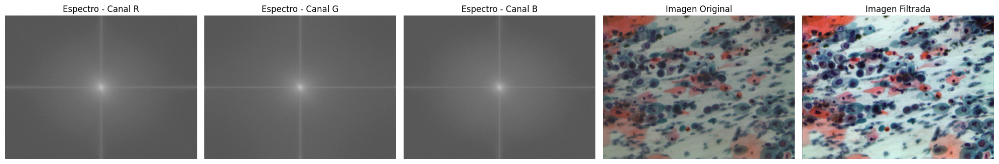

In [ ]:
Image_009_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/009.bmp')

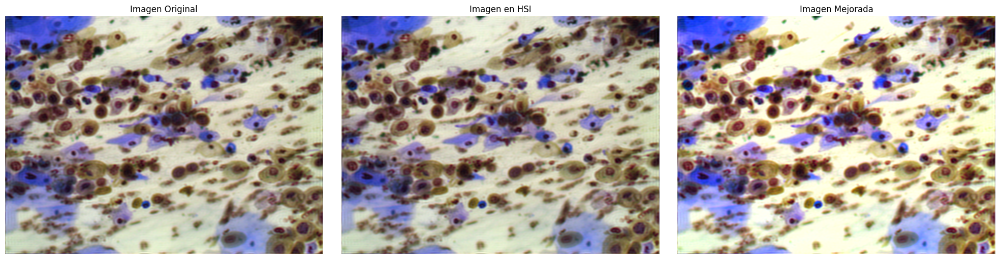

In [ ]:
Image_009_hsi = enhance_image_hsi(Image_009_fft)

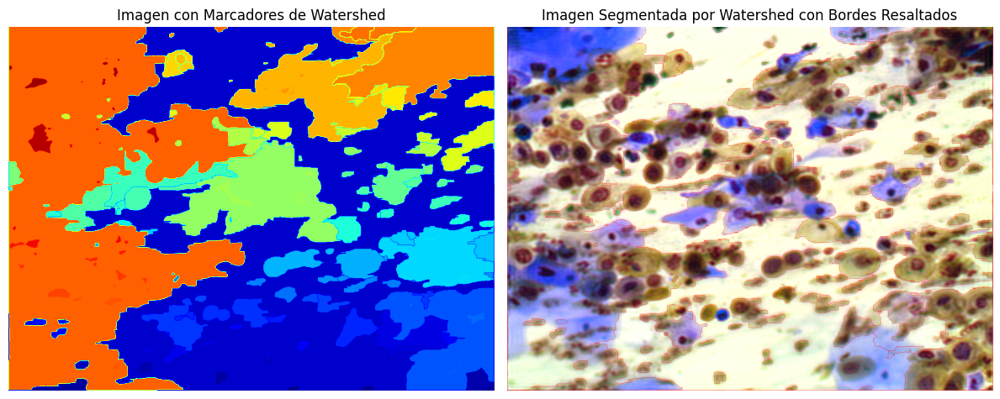

In [ ]:
from sklearn.decomposition import PCA
# Función para aplicar PCA en los tres canales de la imagen
def apply_pca_to_image(image, n_components=1):
    """
    Aplica PCA a una imagen en los tres canales BGR para reducir el ruido y resaltar las características principales.

    Parámetros:
    - image: Imagen de entrada en formato BGR.
    - n_components: Número de componentes principales a conservar para PCA.

    Retorna:
    - Imagen procesada con PCA aplicada a cada canal.
    """
    # Separar los tres canales BGR
    (B, G, R) = cv2.split(image)

    # Inicializar PCA
    pca = PCA(n_components=n_components)

    # Función para aplicar PCA a un canal
    def apply_pca_to_channel(channel):
        # Normalizar el canal a valores entre 0 y 1
        normalized_channel = channel / 255.0
        h, w = normalized_channel.shape
        reshaped_channel = normalized_channel.reshape(h * w, 1)

        # Aplicar PCA
        pca_result = pca.fit_transform(reshaped_channel)

        # Reconstruir la imagen del canal con los componentes principales
        reconstructed_channel = pca.inverse_transform(pca_result).reshape(h, w)

        # Escalar la imagen reconstruida de vuelta al rango [0, 255]
        pca_channel = np.uint8(reconstructed_channel * 255)
        return pca_channel

    # Aplicar PCA a cada uno de los canales
    pca_R = apply_pca_to_channel(R)
    pca_G = apply_pca_to_channel(G)
    pca_B = apply_pca_to_channel(B)

    # Volver a combinar los canales procesados con PCA
    pca_image = cv2.merge([pca_B, pca_G, pca_R])

    return pca_image

# Convertir la imagen a 8 bits sin signo (CV_8U)
Image_009_hsi = Image_009_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_009_hsi_pca = apply_pca_to_image(Image_009_hsi, n_components=1)


# Convertir la imagen filtrada a escala de grises
gray_filtered_009 = cv2.cvtColor(Image_009_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un filtro de desenfoque gaussiano para reducir el ruido
blurred_009 = cv2.GaussianBlur(gray_filtered_009, (5, 5), 0)

# Realizar una operación de umbralización para segmentar el objeto de interés
ret, thresh_009 = cv2.threshold(blurred_009, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Encontrar los contornos en la imagen binaria
contours_009, hierarchy_009 = cv2.findContours(thresh_009, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

# Crear una imagen de marcadores para el algoritmo de watershed
markers_009 = np.zeros(gray_filtered_009.shape, dtype=np.int32)
for i in range(len(contours_009)):
    cv2.drawContours(markers_009, contours_009, i, (i + 1), -1)

# Aplicar el algoritmo de watershed
cv2.watershed(Image_009_hsi_pca, markers_009)

# Resaltar los bordes de la segmentación en la imagen original
# Define segmented_image_009 here, similar to how it's done for image_008
segmented_image_009 = Image_009_hsi_pca.copy()
segmented_image_009[markers_009 == -1] = [0, 0, 255]  # Bordes en rojo

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers_009, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(segmented_image_009, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

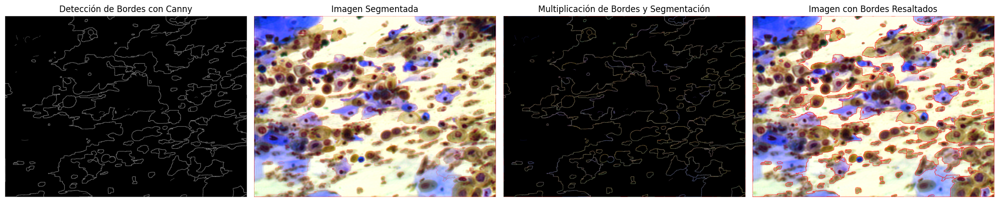

In [ ]:
Imagen_009_bordes = detect_edges_and_highlight(segmented_image_009)

###Imagen 2

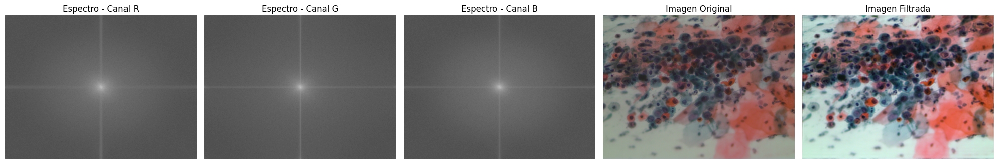

In [ ]:
Image_011_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/011.bmp')

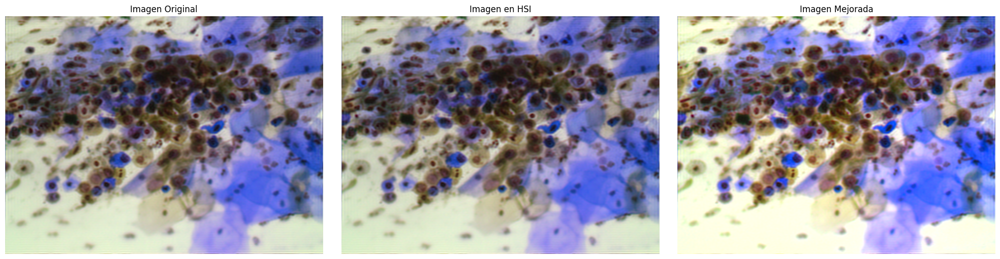

In [ ]:
Image_011_hsi = enhance_image_hsi(Image_011_fft)

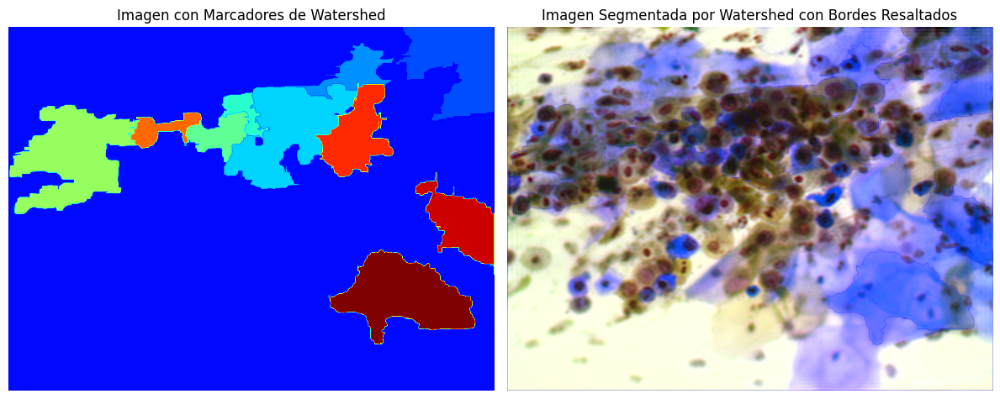

In [ ]:
# Convertir la imagen a 8 bits sin signo (CV_8U)
Image_011_hsi = Image_011_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_011_hsi_pca = apply_pca_to_image(Image_011_hsi, n_components=1)

# Convertir la imagen filtrada a escala de grises
gray_Image_011_hsi_pca = cv2.cvtColor(Image_011_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_011_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_011_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color rojo brillante
Image_011_hsi_pca[markers == -1] = [255, 0, 0]  # Bordes en rojo

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_011_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

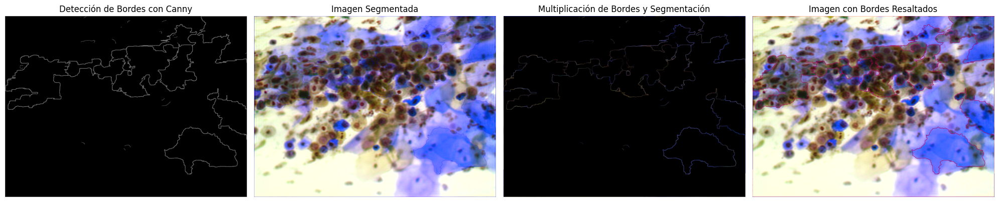

In [ ]:
Imagen_011_bordes = detect_edges_and_highlight(Image_011_hsi_pca)

##Células Koilocíticas

###Imagen 1

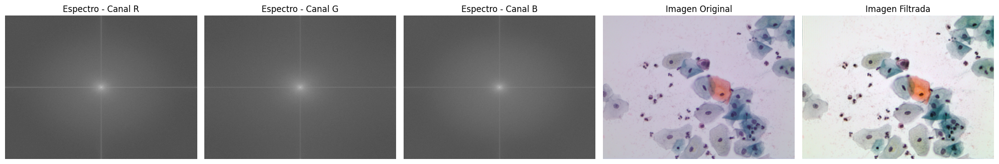

In [ ]:
Image_004_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/004.bmp')

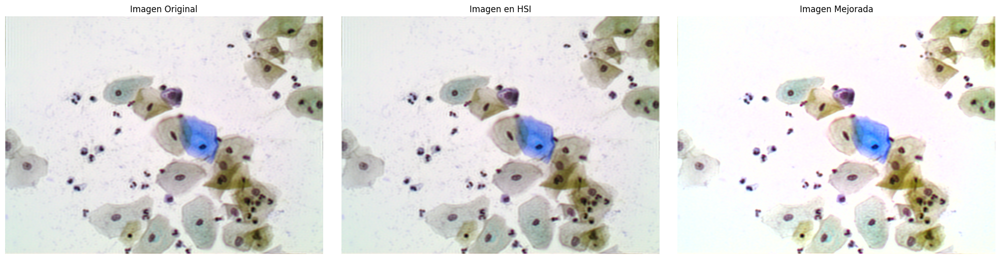

In [ ]:
# Leer la imagen en formato BGR
image_bgr = Image_004_fft

# Segmentar las células koilocíticas
result_image = enhance_image_hsi(image_bgr)

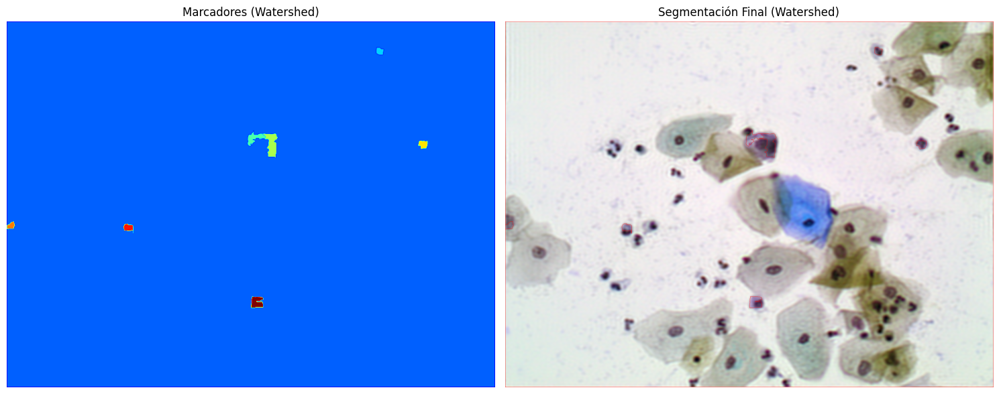

In [ ]:
def watershed_only_results(image_bgr):
    """
    Aplica Watershed y muestra únicamente los resultados de los marcadores y la segmentación final,
    sin llamar a funciones que muestren imágenes intermedias.

    Parameters:
    - image_bgr: Imagen original en formato BGR (de OpenCV).

    Returns:
    - segmented_image: Imagen con las regiones segmentadas utilizando Watershed.
    - markers: Marcadores generados por Watershed.
    """
    # Convertir la imagen original a HSI
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    img_hsi = rgb_to_hsi(image_rgb)

    # Separar los canales H, S e I
    h, s, i = img_hsi[:, :, 0], img_hsi[:, :, 1], img_hsi[:, :, 2]

    # Definir rangos para las células koilocíticas
    hue_min, hue_max = 0.70, 0.80
    sat_min, sat_max = 0.0, 1.0
    int_min, int_max = 0.0, 0.7

    # Crear una máscara basada en HSI
    mask = (
        (h >= hue_min) & (h <= hue_max) &
        (s >= sat_min) & (s <= sat_max) &
        (i >= int_min) & (i <= int_max)
    )
    mask_binary = (mask.astype(np.uint8)) * 255

    # Operaciones morfológicas para limpiar la máscara
    kernel = np.ones((5, 5), np.uint8)
    mask_cleaned = cv2.morphologyEx(mask_binary, cv2.MORPH_CLOSE, kernel, iterations=3)
    mask_cleaned = cv2.morphologyEx(mask_cleaned, cv2.MORPH_OPEN, kernel, iterations=2)

    # Convertir la máscara a escala de grises
    gray_mask = cv2.cvtColor(cv2.merge([mask_cleaned] * 3), cv2.COLOR_BGR2GRAY)

    # Paso 2: Identificar regiones de fondo y de primer plano
    sure_bg = cv2.dilate(gray_mask, kernel, iterations=3)
    dist_transform = cv2.distanceTransform(gray_mask, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.5 * dist_transform.max(), 255, 0)

    # Encontrar regiones desconocidas
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Paso 3: Crear marcadores para Watershed
    ret, markers = cv2.connectedComponents(sure_fg)
    markers = markers + 1
    markers[unknown == 255] = 0

    # Aplicar Watershed
    segmented_image = image_bgr.copy()
    markers = cv2.watershed(segmented_image, markers)

    # Dibujar bordes en las regiones segmentadas
    segmented_image[markers == -1] = [0, 0, 255]  # Bordes en rojo

    # Mostrar solo los resultados de Watershed
    plt.figure(figsize=(15, 7))

    # Mostrar marcadores
    plt.subplot(1, 2, 1)
    plt.imshow(markers, cmap="jet")
    plt.title("Marcadores (Watershed)")
    plt.axis("off")

    # Mostrar segmentación final
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
    plt.title("Segmentación Final (Watershed)")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    return segmented_image, markers
segmented_image, markers = watershed_only_results(image_bgr)

In [ ]:
def segment_with_hsi_v2(image_bgr):
    """
    Segmenta células koilocíticas usando una combinación de HSI (para rango de colores)
    y algoritmos de Watershed y Canny para refinar la segmentación.

    Parameters:
    - image_bgr: Imagen original en formato BGR (de OpenCV).

    Returns:
    - segmented_image: Imagen con las células koilocíticas segmentadas y resaltadas.
    """
    # Paso 1: Generar máscara inicial basada en HSI
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    img_hsi = rgb_to_hsi(image_rgb)

    # Separar los canales H, S, I
    h, s, i = img_hsi[:, :, 0], img_hsi[:, :, 1], img_hsi[:, :, 2]

    # Definir rangos para las células koilocíticas
    hue_min, hue_max = 0.70, 0.80
    sat_min, sat_max = 0.0, 1.0
    int_min, int_max = 0.0, 0.7

    # Crear una máscara basada en HSI
    mask = (
        (h >= hue_min) & (h <= hue_max) &
        (s >= sat_min) & (s <= sat_max) &
        (i >= int_min) & (i <= int_max)
    )
    mask_binary = (mask.astype(np.uint8)) * 255

    # Operaciones morfológicas para limpiar la máscara
    kernel = np.ones((5, 5), np.uint8)
    mask_cleaned = cv2.morphologyEx(mask_binary, cv2.MORPH_CLOSE, kernel, iterations=3)
    mask_cleaned = cv2.morphologyEx(mask_cleaned, cv2.MORPH_OPEN, kernel, iterations=2)

    # Paso 2: Usar la máscara como entrada para Watershed
    # Eliminar ruido con operaciones morfológicas adicionales
    opening = cv2.morphologyEx(mask_cleaned, cv2.MORPH_OPEN, kernel, iterations=2)

    # Identificar regiones de fondo y de primer plano
    sure_bg = cv2.dilate(opening, kernel, iterations=3)
    dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

    # Encontrar regiones desconocidas
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Crear marcadores para Watershed
    ret, markers = cv2.connectedComponents(sure_fg)
    markers = markers + 1
    markers[unknown == 255] = 0

    # Dibujar bordes en las regiones segmentadas
    segmented_image[markers == -1] = [0, 0, 255]  # Bordes en rojo

    # Paso 3: Aplicar Canny para detectar bordes finales
    edges = cv2.Canny(mask_cleaned, 50, 150)

    # Mostrar resultados
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB))
    plt.title("Imagen Original")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(mask_cleaned, cmap="gray")
    plt.title("Máscara Inicial (HSI)")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
    plt.title("Segmentación Final (Watershed)")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    return segmented_image


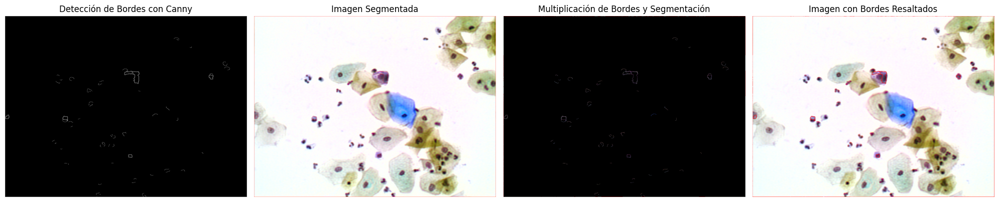

In [ ]:
Imagen_004_bordes = detect_edges_and_highlight(segmented_image)

###Imagen 2

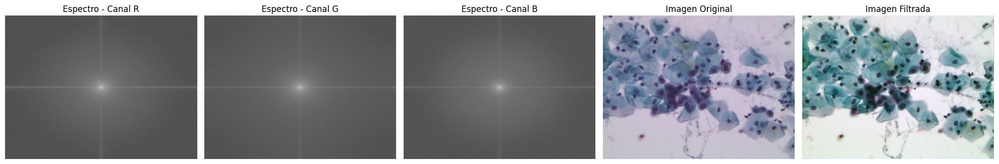

In [ ]:
Image_007_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/007.bmp')

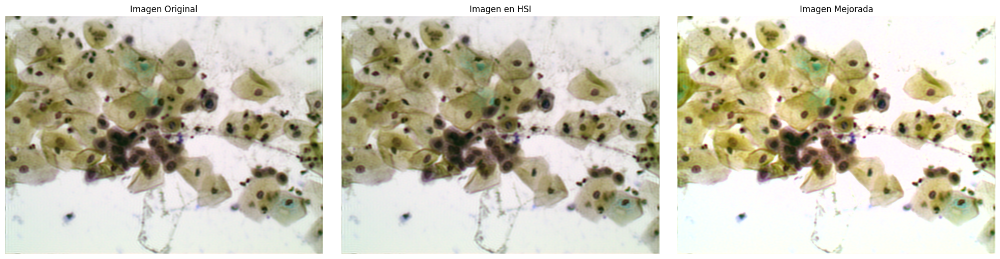

In [ ]:
# Leer la imagen en formato BGR
image_bgr2 = Image_007_fft

# Segmentar las células koilocíticas
result_image2 = enhance_image_hsi(image_bgr2)

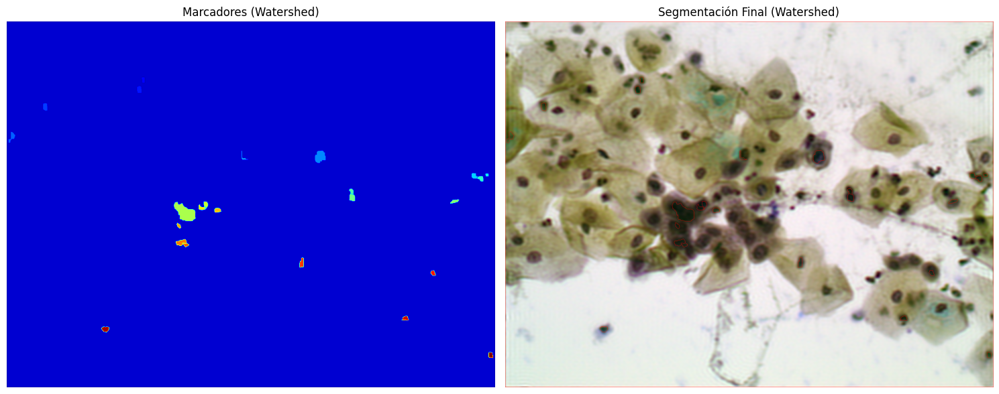

In [ ]:
def watershed_refined(image_bgr):
    """
    Segmenta células koilocíticas en cúmulos, diferenciándolas de las células superficiales intermedias.

    Parameters:
    - image_bgr: Imagen original en formato BGR (de OpenCV).

    Returns:
    - segmented_image: Imagen con las regiones segmentadas.
    - markers: Marcadores generados por Watershed.
    """

    # Convertir la imagen mejorada a HSI
    image_rgb2 = cv2.cvtColor(result_image2, cv2.COLOR_BGR2RGB)
    img_hsi = rgb_to_hsi(image_rgb2)

    # Separar los canales H, S e I
    h, s, i = img_hsi[:, :, 0], img_hsi[:, :, 1], img_hsi[:, :, 2]

    # Ajustar rangos HSI para detectar células koilocíticas
    hue_min, hue_max = 0.2, 0.75
    sat_min, sat_max = 0.0, 0.8
    int_min, int_max = 0.0, 0.38

    # Crear una máscara basada en HSI
    mask = (
        (h >= hue_min) & (h <= hue_max) &
        (s >= sat_min) & (s <= sat_max) &
        (i >= int_min) & (i <= int_max)
    )
    mask_binary = (mask.astype(np.uint8)) * 255

    # Operaciones morfológicas para limpiar la máscara
    kernel = np.ones((3, 3), np.uint8)
    mask_cleaned = cv2.morphologyEx(mask_binary, cv2.MORPH_CLOSE, kernel, iterations=1)
    mask_cleaned = cv2.morphologyEx(mask_cleaned, cv2.MORPH_OPEN, kernel, iterations=2)

    # Filtrar regiones pequeñas por área
    contours, _ = cv2.findContours(mask_cleaned, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    min_area = 300
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > min_area]
    filtered_mask = np.zeros_like(mask_cleaned)
    cv2.drawContours(filtered_mask, filtered_contours, -1, 255, thickness=cv2.FILLED)

    # Convertir la máscara a escala de grises
    gray_mask = cv2.cvtColor(cv2.merge([filtered_mask] * 3), cv2.COLOR_BGR2GRAY)

    # Paso 2: Identificar regiones de fondo y de primer plano
    sure_bg = cv2.dilate(gray_mask, kernel, iterations=3)
    dist_transform = cv2.distanceTransform(gray_mask, cv2.DIST_L2, 5)
    ret, sure_fg = cv2.threshold(dist_transform, 0.3 * dist_transform.max(), 255, 0)

    # Encontrar regiones desconocidas
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)

    # Paso 3: Crear marcadores para Watershed
    ret, markers = cv2.connectedComponents(sure_fg)
    markers = markers + 1
    markers[unknown == 255] = 0

    # Aplicar Watershed
    segmented_image = image_bgr2.copy()
    markers = cv2.watershed(segmented_image, markers)

    # Dibujar bordes en las regiones segmentadas
    segmented_image[markers == -1] = [0, 0, 255]  # Bordes en rojo

    # Mostrar solo los resultados de Watershed
    plt.figure(figsize=(15, 7))

    # Mostrar marcadores
    plt.subplot(1, 2, 1)
    plt.imshow(markers, cmap="jet")
    plt.title("Marcadores (Watershed)")
    plt.axis("off")

    # Mostrar segmentación final
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))
    plt.title("Segmentación Final (Watershed)")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

    return segmented_image, markers

# Aplicar la función con la imagen mejorada
segmented_image_007, markers_007 = watershed_refined(image_bgr2)


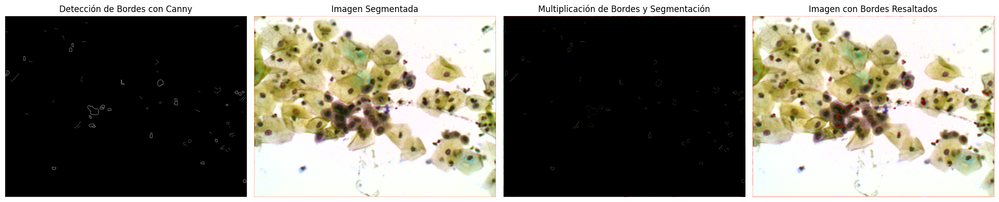

In [ ]:
Imagen_007_bordes = detect_edges_and_highlight(segmented_image_007)

##Células Metaplásticas

###Imagen 1

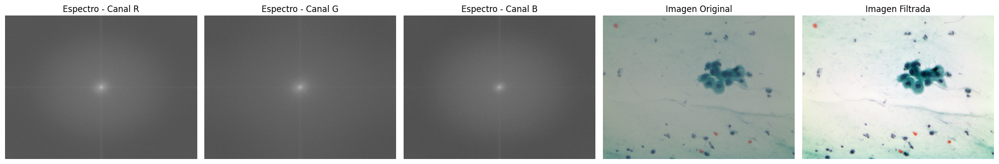

In [ ]:
Image_0071_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/007(1).bmp')

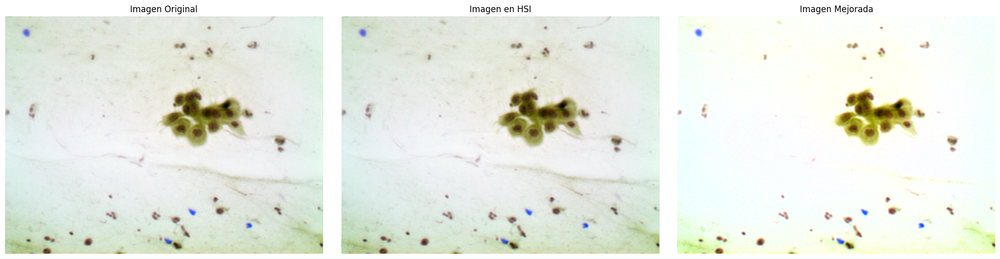

In [ ]:
Image_0071_hsi = enhance_image_hsi(Image_0071_fft)

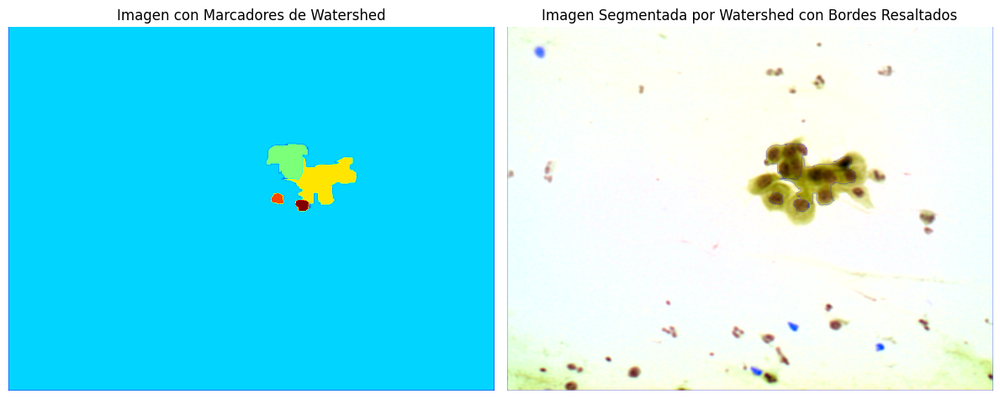

In [ ]:
# Convertir la imagen a 8 bits sin signo (CV_8U)
Image_0071_hsi = Image_0071_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_0071_hsi_pca = apply_pca_to_image(Image_0071_hsi, n_components=1)

# Convertir la imagen filtrada a escala de grises
gray_Image_0071_hsi_pca = cv2.cvtColor(Image_0071_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_0071_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_0071_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color rojo brillante
Image_0071_hsi_pca[markers == -1] = [255, 0, 0]  # Bordes en rojo

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_0071_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

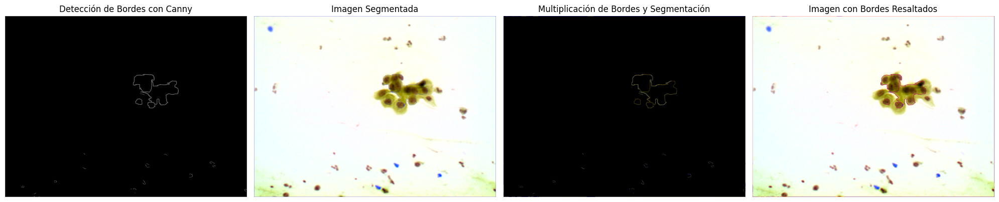

In [ ]:
Imagen_0071_bordes = detect_edges_and_highlight(Image_0071_hsi_pca)

###Imagen 2

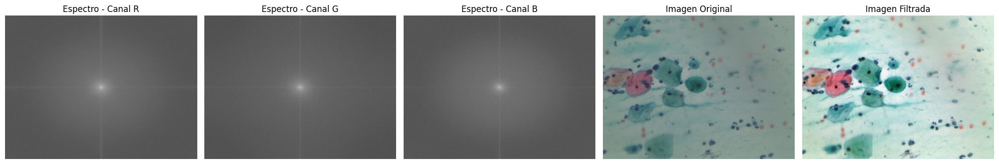

In [ ]:
Image_026_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/026.bmp')

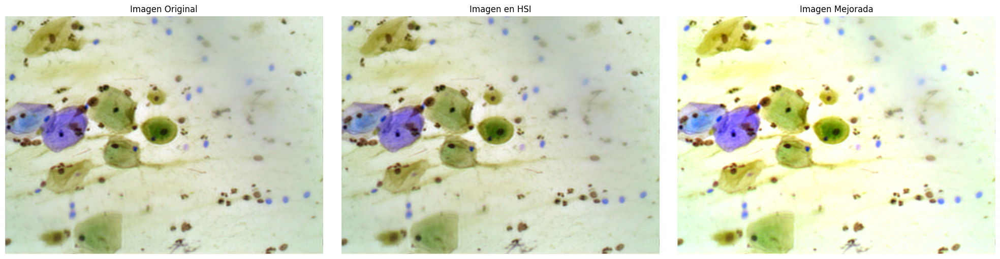

In [ ]:
Image_026_hsi = enhance_image_hsi(Image_026_fft)

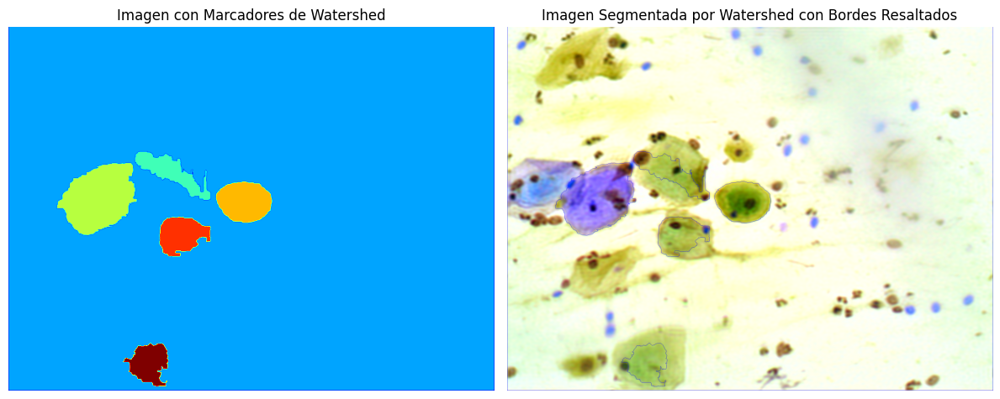

In [ ]:
# Convertir la imagen a 8 bits sin signo (CV_8U)
Image_026_hsi = Image_026_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_026_hsi_pca = apply_pca_to_image(Image_026_hsi, n_components=1)

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Convertir la imagen filtrada a escala de grises
gray_Image_026_hsi_pca = cv2.cvtColor(Image_026_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_026_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_026_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color rojo brillante
Image_026_hsi_pca[markers == -1] = [255, 0, 0]  # Bordes en rojo

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_026_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

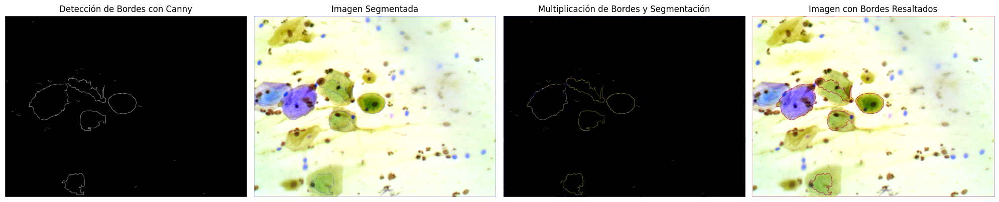

In [ ]:
Imagen_026_bordes = detect_edges_and_highlight(Image_026_hsi_pca)

##Células Parabasales

###Imagen 1

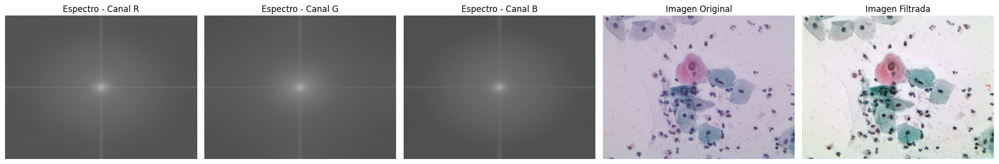

In [ ]:
Image_005_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/005.bmp')

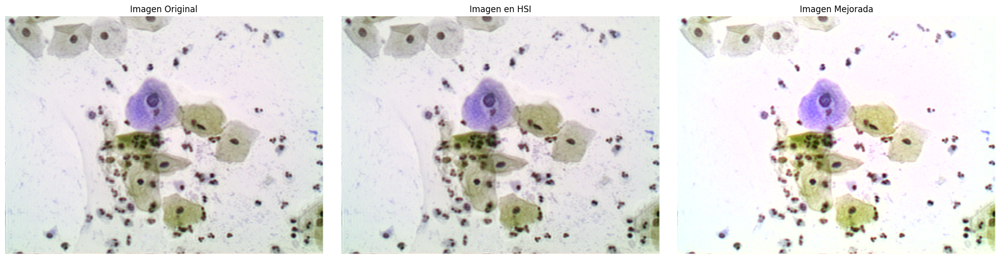

In [ ]:
Image_005_hsi = enhance_image_hsi(Image_005_fft)

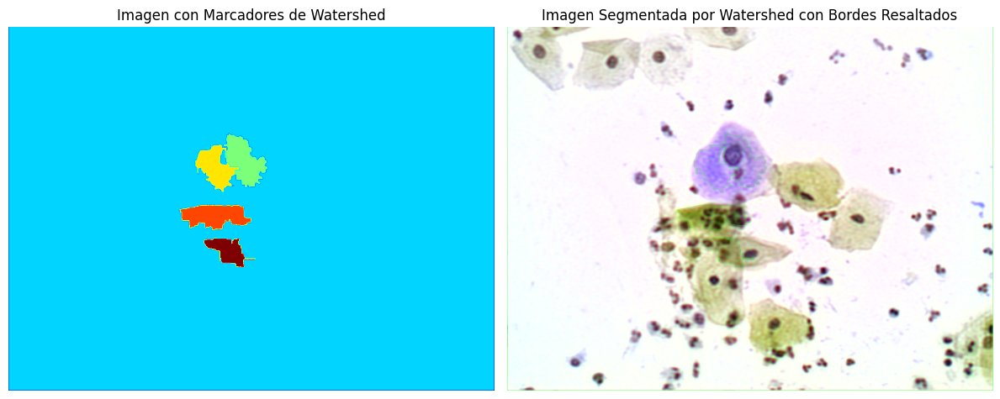

In [ ]:
Image_005_hsi = Image_005_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_005_hsi_pca = apply_pca_to_image(Image_005_hsi, n_components=1)

# Convertir la imagen filtrada a escala de grises
gray_Image_005_hsi_pca = cv2.cvtColor(Image_005_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_005_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_005_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color brillante
Image_005_hsi_pca[markers == -1] = [0, 255, 0]

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_005_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

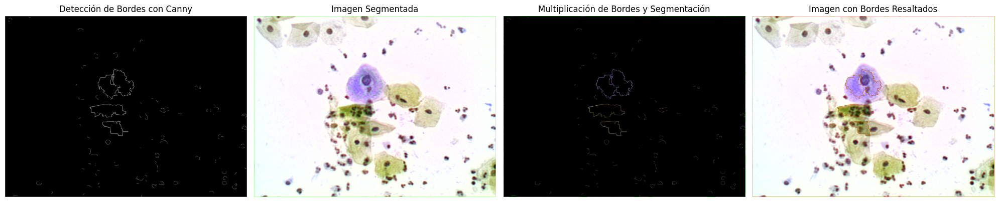

In [ ]:
Imagen_005_bordes = detect_edges_and_highlight(Image_005_hsi_pca)

###Imagen 2

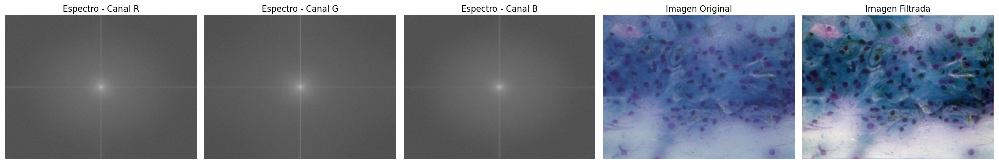

In [ ]:
Image_013_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/013.bmp')

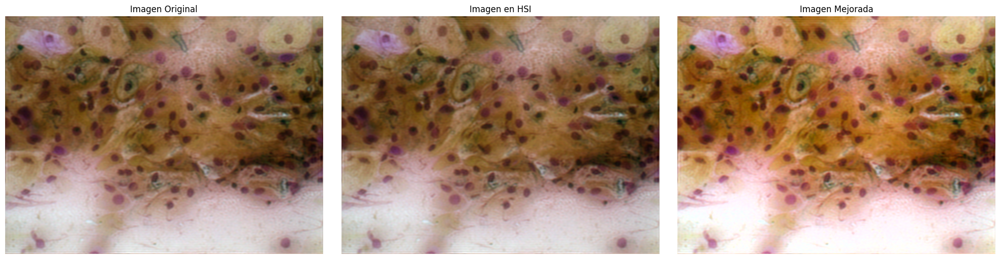

In [ ]:
Image_013_hsi = enhance_image_hsi(Image_013_fft)

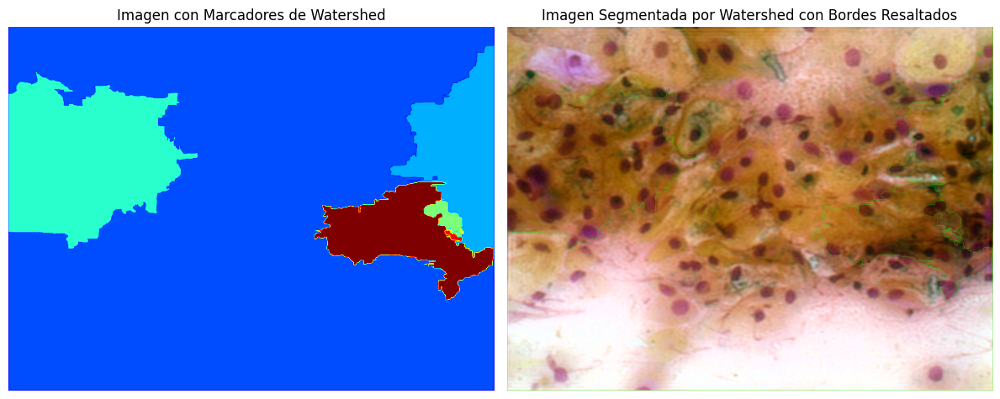

In [ ]:
Image_013_hsi = Image_013_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_013_hsi_pca = apply_pca_to_image(Image_013_hsi, n_components=1)

# Convertir la imagen filtrada a escala de grises
gray_Image_013_hsi_pca = cv2.cvtColor(Image_013_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_013_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_013_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color brillante
Image_013_hsi_pca[markers == -1] = [0, 255, 0]

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_013_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

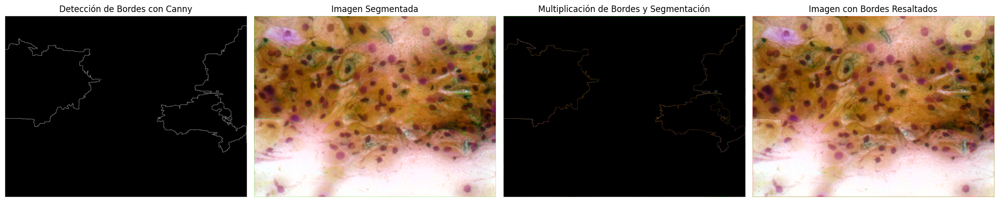

In [ ]:
Imagen_013_bordes = detect_edges_and_highlight(Image_013_hsi_pca)

##Células Superficiales - intermedias

###Imagen 1

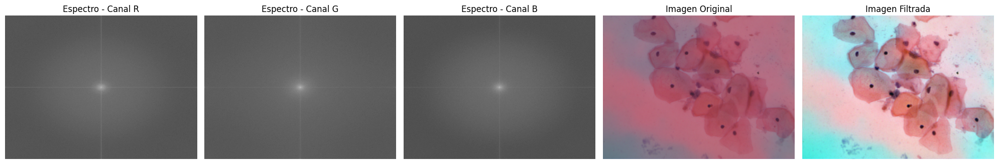

In [ ]:
Image_0091_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/009(1).bmp')

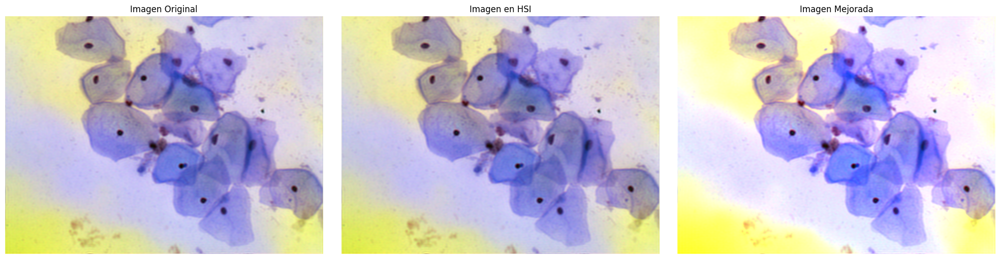

In [ ]:
Image_0091_hsi = enhance_image_hsi(Image_0091_fft)

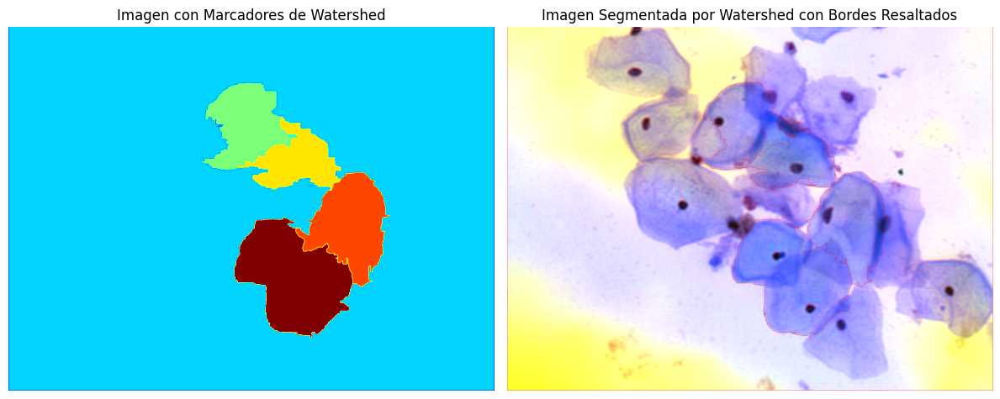

In [ ]:
Image_0091_hsi = Image_0091_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_0091_hsi_pca = apply_pca_to_image(Image_0091_hsi, n_components=1)

# Convertir la imagen filtrada a escala de grises
gray_Image_0091_hsi_pca = cv2.cvtColor(Image_0091_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_0091_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_0091_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color brillante
Image_0091_hsi_pca[markers == -1] = [0, 0, 255]

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_0091_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

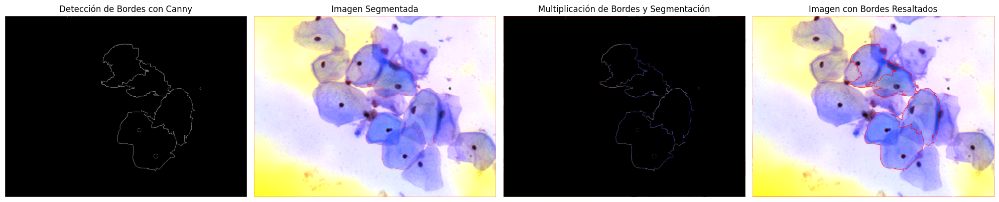

In [ ]:
Imagen_0091_bordes = detect_edges_and_highlight(Image_0091_hsi_pca)

###Imagen 2

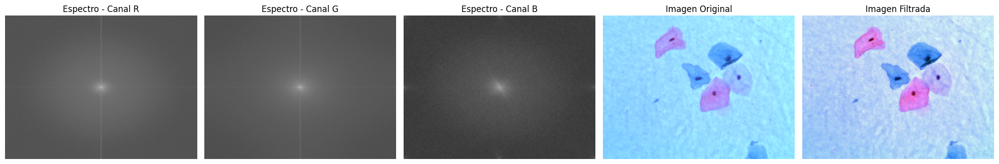

In [ ]:
Image_012_fft = procesar_imagen_fft('/content/drive/MyDrive/images bmp/012.bmp')

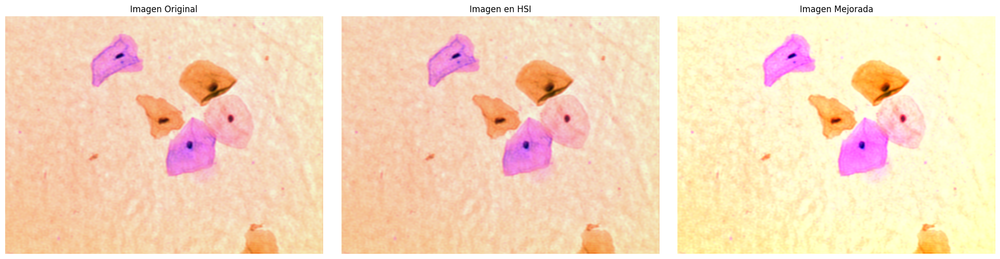

In [ ]:
Image_012_hsi = enhance_image_hsi(Image_012_fft)

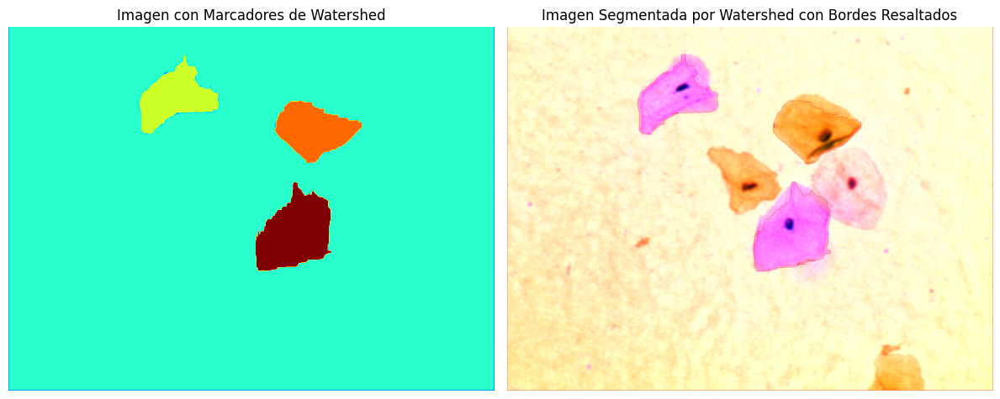

In [ ]:
Image_012_hsi = Image_012_hsi.astype(np.uint8)

# Aplicar PCA a la imagen
Image_012_hsi_pca = apply_pca_to_image(Image_012_hsi, n_components=1)

# Convertir la imagen filtrada a escala de grises
gray_Image_012_hsi_pca = cv2.cvtColor(Image_012_hsi_pca, cv2.COLOR_BGR2GRAY)

# Aplicar un umbral para obtener una imagen binaria
ret, thresh = cv2.threshold(gray_Image_012_hsi_pca, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

# Eliminar ruido con una operación morfológica (apertura)
kernel = np.ones((3, 3), np.uint8)
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=2)

# Encontrar marcadores seguros (background)
sure_bg = cv2.dilate(opening, kernel, iterations=3)

# Encontrar marcadores seguros (foreground)
dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
ret, sure_fg = cv2.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)

# Convertir a uint8
sure_fg = np.uint8(sure_fg)

# Encontrar la región desconocida
unknown = cv2.subtract(sure_bg, sure_fg)

# Etiquetar marcadores
ret, markers = cv2.connectedComponents(sure_fg)

# Añadir 1 a todos los marcadores para asegurarse de que el fondo es 0, no 1
markers = markers + 1

# Marcar la región desconocida con 0
markers[unknown == 255] = 0

# Aplicar el algoritmo de watershed
markers = cv2.watershed(Image_012_hsi_pca, markers)

# Resaltar las fronteras detectadas con un color brillante
Image_012_hsi_pca[markers == -1] = [0, 0, 255]

# Crear una figura con 2 filas y 2 columnas - Corrected to 1 row, 2 columns
fig, axes = plt.subplots(1, 2, figsize=(12, 12))

# Mostrar la imagen con los marcadores de Watershed
axes[0].imshow(markers, cmap='jet') # Corrected: Accessing the first subplot using a single index
axes[0].set_title('Imagen con Marcadores de Watershed')
axes[0].axis('off')

# Mostrar la imagen segmentada con los bordes resaltados
axes[1].imshow(cv2.cvtColor(Image_012_hsi_pca, cv2.COLOR_BGR2RGB)) # Corrected: Accessing the second subplot using a single index
axes[1].set_title('Imagen Segmentada por Watershed con Bordes Resaltados')
axes[1].axis('off')

# Ajustar el layout y mostrar todas las imágenes
plt.tight_layout()
plt.show()

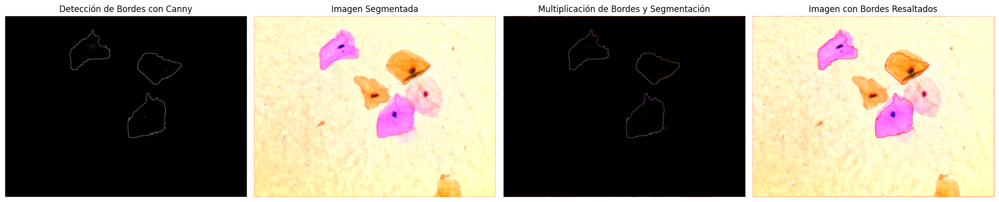

In [ ]:
Imagen_012_bordes = detect_edges_and_highlight(Image_012_hsi_pca)